In [1]:
import stream as st
from rpy2.robjects.packages import importr
import rpy2.robjects as robjects
## import velocyto as vcy
import scanpy as sc
import scvelo as scv
import numpy as np
import pandas as pd
utils = importr("utils")
import loompy
loompy.__version__
seurat = importr("Seurat")
scv.settings.set_figure_params('scvelo')
scv.settings.verbosity = 3
sc.logging.print_versions()

scanpy==1.4.4.post1 anndata==0.6.22.post1 umap==0.3.10 numpy==1.17.2 scipy==1.3.1 pandas==0.23.4 scikit-learn==0.21.3 statsmodels==0.10.1 python-igraph==0.7.1 louvain==0.6.1


In [2]:
def compute_velocity(loom, mito_prefix='MT-', cutoff=[5000, 0.15], norm=False):
    if isinstance(loom, str):
#         adata = scv.read(loom, cache=True) ## this is not working for Seurat output loom file
        adata= sc.read_loom(loom)
    elif len(loom) == 1:
        adata = scv.read(loom[0], cache=True)
    elif len(loom) > 1:
        adata = scv.read(loom[0], cache=True)
        adata2 = scv.read(loom[1], cache=True)
        adata = adata.concatenate(adata2, batch_key='library')
        
    adata.var_names_make_unique()
    cells = adata.obs.index
    print(adata.layers)
    if not norm:
        sc.pp.filter_cells(adata, min_genes=1000)
        sc.pp.filter_genes(adata, min_cells=5)
        mito_genes = adata.var_names.str.startswith(mito_prefix)
        # for each cell compute fraction of counts in mito genes vs. all genes
        # the `.A1` is only necessary as X is sparse (to transform to a dense array after summing)
        adata.obs['percent_mito'] = np.sum(
            adata[:, mito_genes].X, axis=1).A1 / np.sum(adata.X, axis=1).A1
        # add the total counts per cell as observations-annotation to adata
        adata.obs['n_counts'] = adata.X.sum(axis=1).A1    
        sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'],
                     jitter=0.4, multi_panel=True)  
    #     print(adata.obs['percent_mito'])
        adata = adata[adata.obs['n_genes'] < cutoff[0], :]
        adata = adata[adata.obs['percent_mito'] < cutoff[1], :]     
        
    scv.pp.filter_and_normalize(adata, min_shared_counts=0, n_top_genes=3000)    
    scv.pp.moments(adata, n_pcs=20, n_neighbors=30)
  #  sc.pp.regress_out(adata, ['n_counts', 'percent_mito'])
  #  sc.pp.scale(adata, max_value=10)
    sc.tl.umap(adata)
    sc.tl.louvain(adata, resolution=0.8)
    scv.tl.velocity(adata, mode='stochastic')
    scv.tl.velocity_graph(adata)
    scv.tl.velocity_embedding(adata, basis='umap')
    scv.tl.rank_velocity_genes(adata, match_with='clusters', resolution=0.8)
    scv.tl.terminal_states(adata, groupby='velocity_clusters')
    scv.tl.velocity_pseudotime(adata, groupby='velocity_clusters')
    select = np.in1d(cells, adata.obs.index.values)
    return adata, select

def plot_velocity(adata, genes):
    scv.pl.velocity_embedding_stream(adata, basis='umap', color=['velocity_clusters'])
    scv.pl.velocity_embedding(adata, basis='umap', dpi=200, arrow_size=1.5)
    scv.pl.velocity_embedding_grid(adata, basis='umap', 
                                   arrow_size=1.5, color=genes,
                                   layer=['velocity', 'spliced'])
    scv.pl.scatter(adata, color=['velocity_pseudotime', 'root_cells', 'end_points'], size=100)
    scv.pl.velocity(adata, var_names=genes, ncols=1, colorbar=True)
    scv.pl.velocity_graph(adata)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


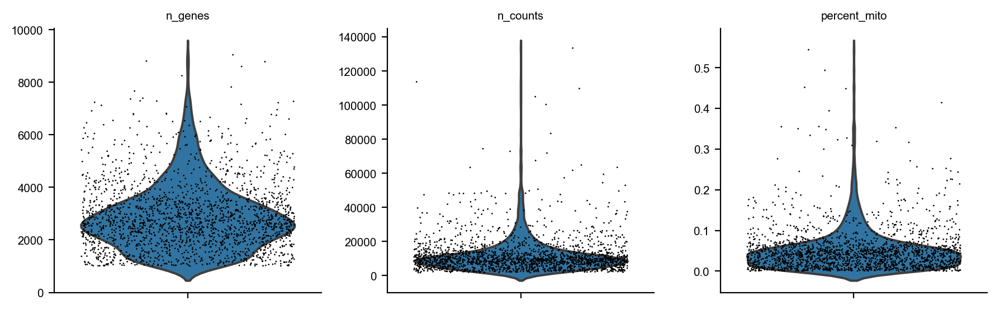

Trying to set attribute `.obs` of view, making a copy.


Filtered out 6193 genes that are detected in less than 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:02) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:02) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


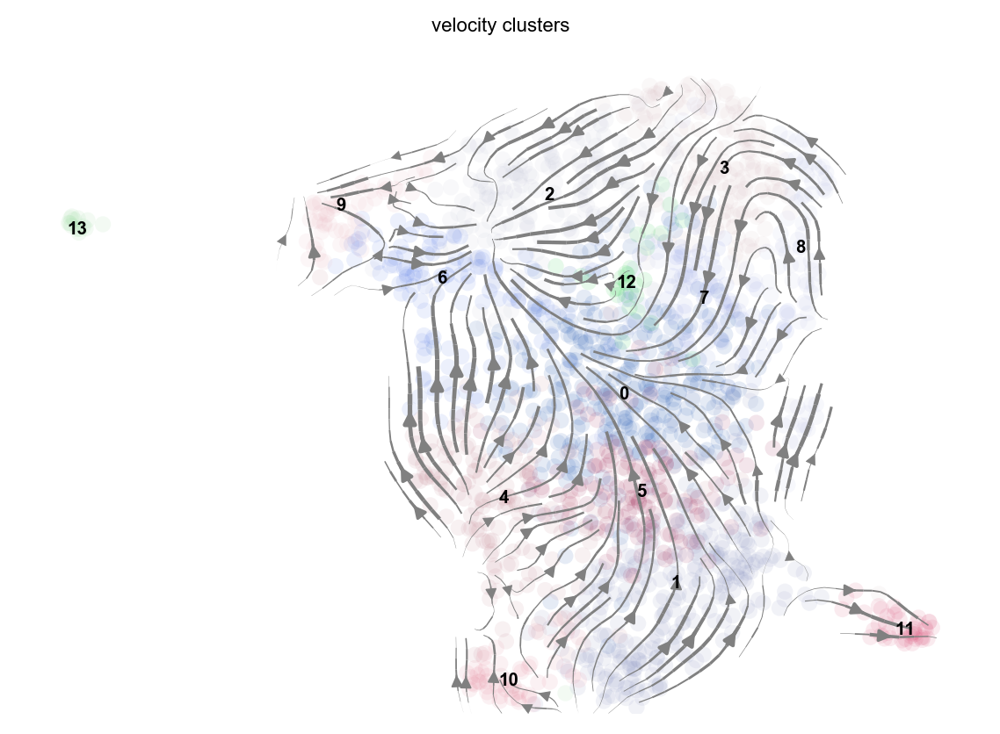

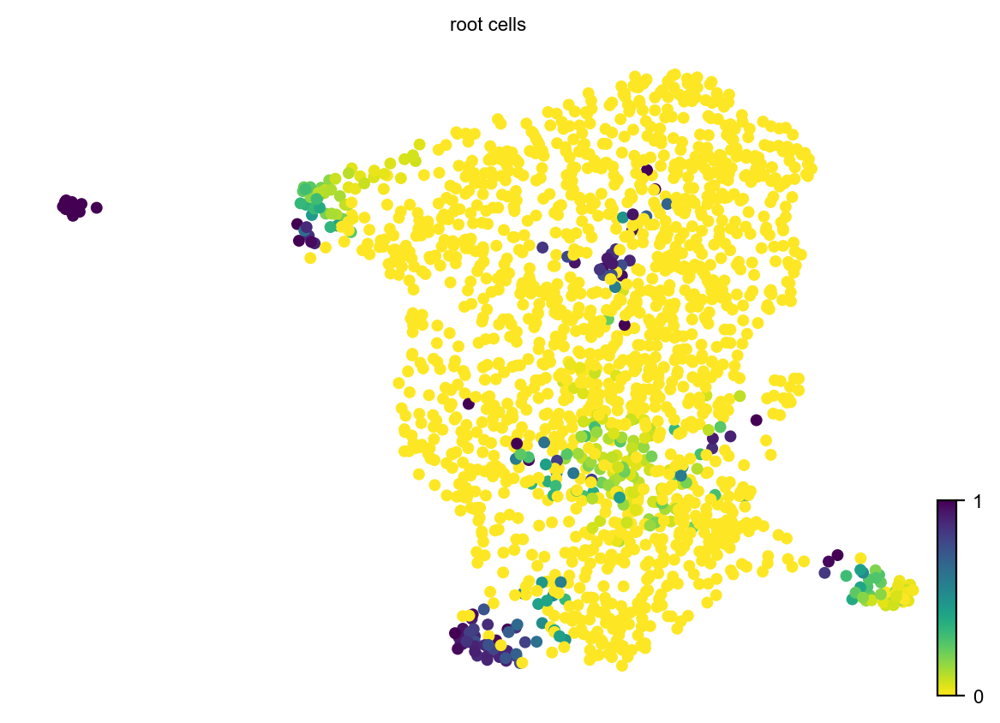

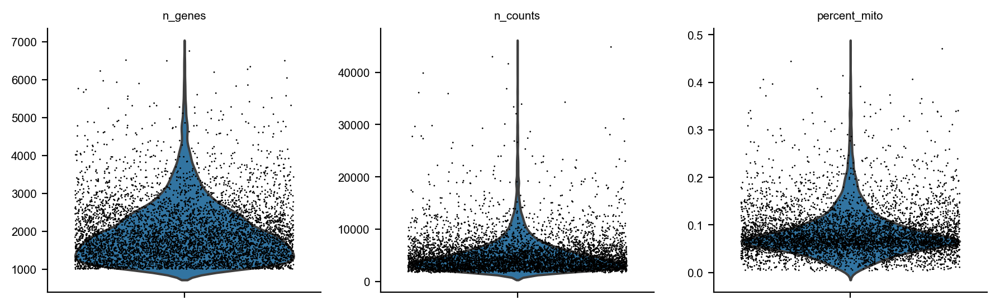

Trying to set attribute `.obs` of view, making a copy.


Filtered out 6878 genes that are detected in less than 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:01) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:09) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:08) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:03) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


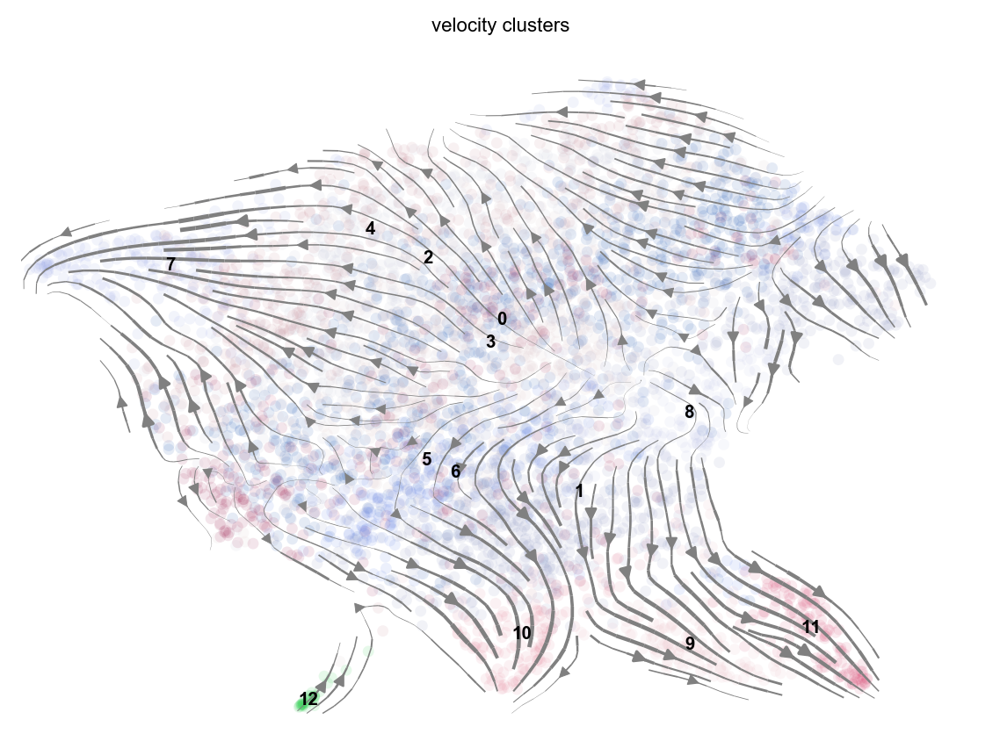

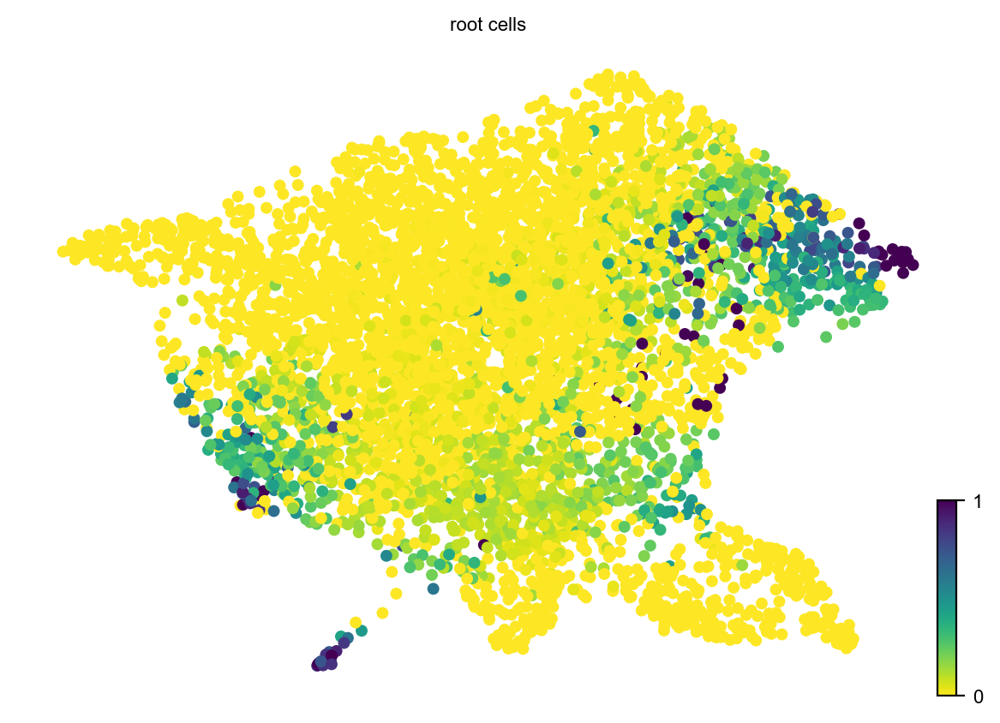

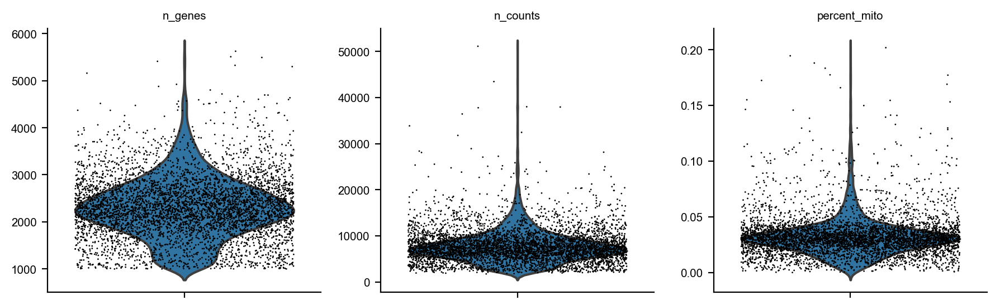

Trying to set attribute `.obs` of view, making a copy.


Filtered out 6731 genes that are detected in less than 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:01) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:07) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:03) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity 

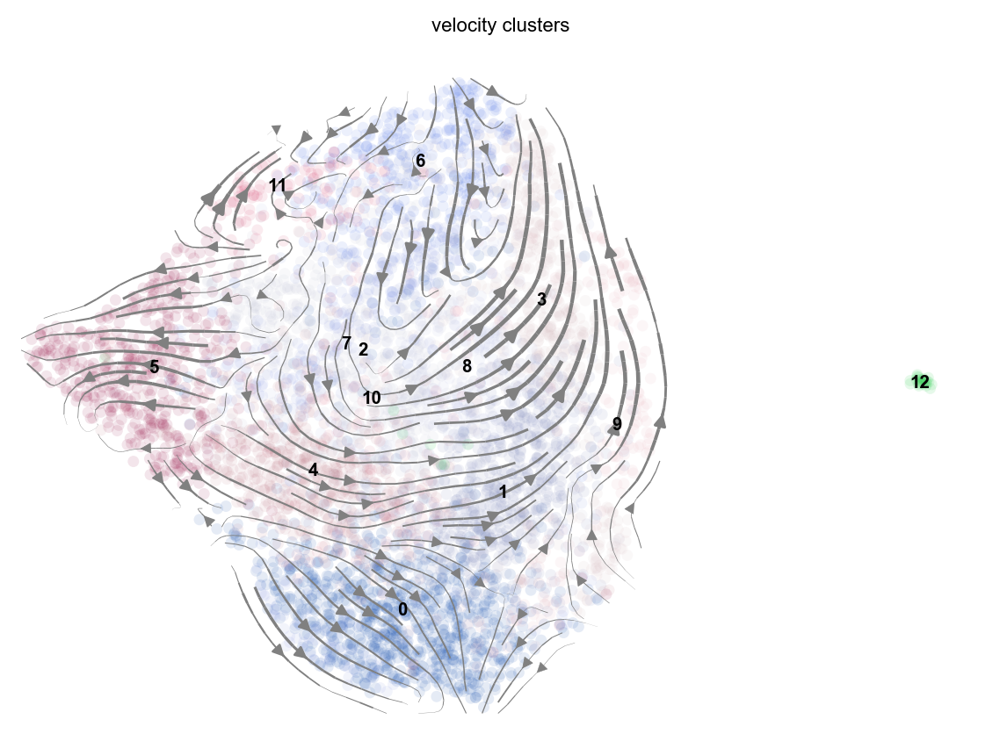

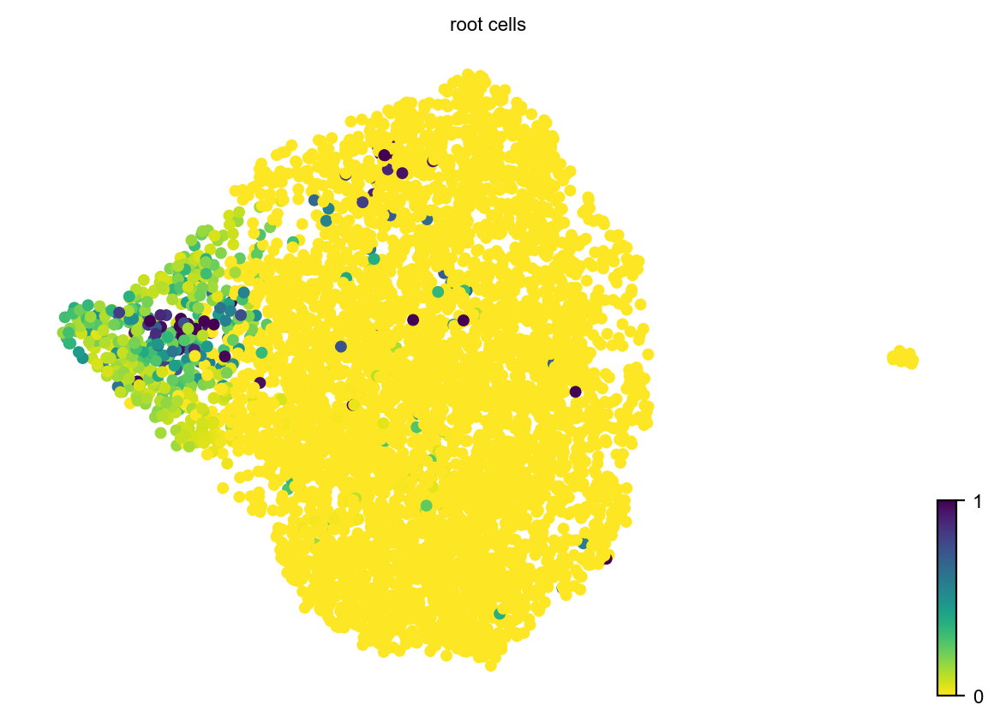

In [6]:
input_loom = {'mast111': '/data/langenau/alvin_singlecell/01_rms_projects/02_human/data/cellranger_counts/20190418_MAST111_5Kcells_hg19/velocyto/20190418_MAST111_5Kcells_hg19.loom',
              'mast139': '/data/langenau/alvin_singlecell/01_rms_projects/02_human/data/cellranger_counts/20190418_MAST139_5Kcells_hg19/velocyto/20190418_MAST139_5Kcells_hg19.loom',
              'rh74': '/data/langenau/alvin_singlecell/01_rms_projects/02_human/data/cellranger_counts/20190618_PDX1_RH74_5Kcells_hg19/velocyto/20190618_PDX1_RH74_5Kcells_hg19.loom'}
              
results_file = '../results/anndata/human/{}.h5ad'  # the file that will store the analysis results
!mkdir -p ../results/anndata/human/
for tumor in input_loom:
    adata = compute_velocity(input_loom[tumor], mito_prefix='MT-')
    adata.write(results_file.format(tumor))
    print(adata.obs.shape, len(adata.var_names))
    #plot_velocity(adata, 'FN1')
    ax1=scv.pl.velocity_embedding_stream(adata, basis='umap', color=['velocity_clusters'], show=False)
    ax2=scv.pl.scatter(adata, color=['root_cells'], size=100, show=False)

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


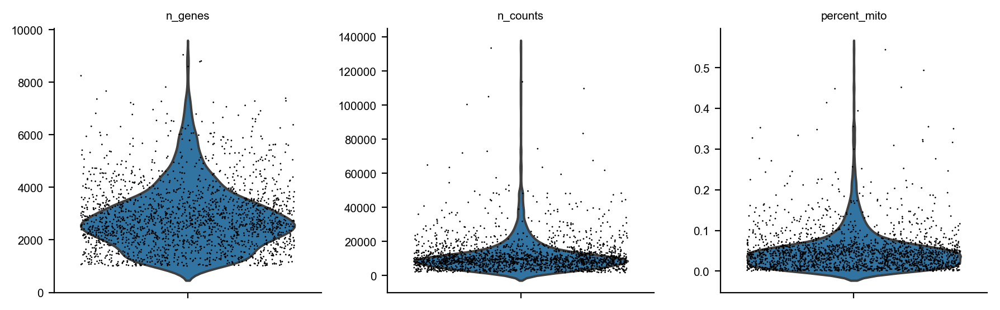

Trying to set attribute `.obs` of view, making a copy.


Filtered out 6193 genes that are detected in less than 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


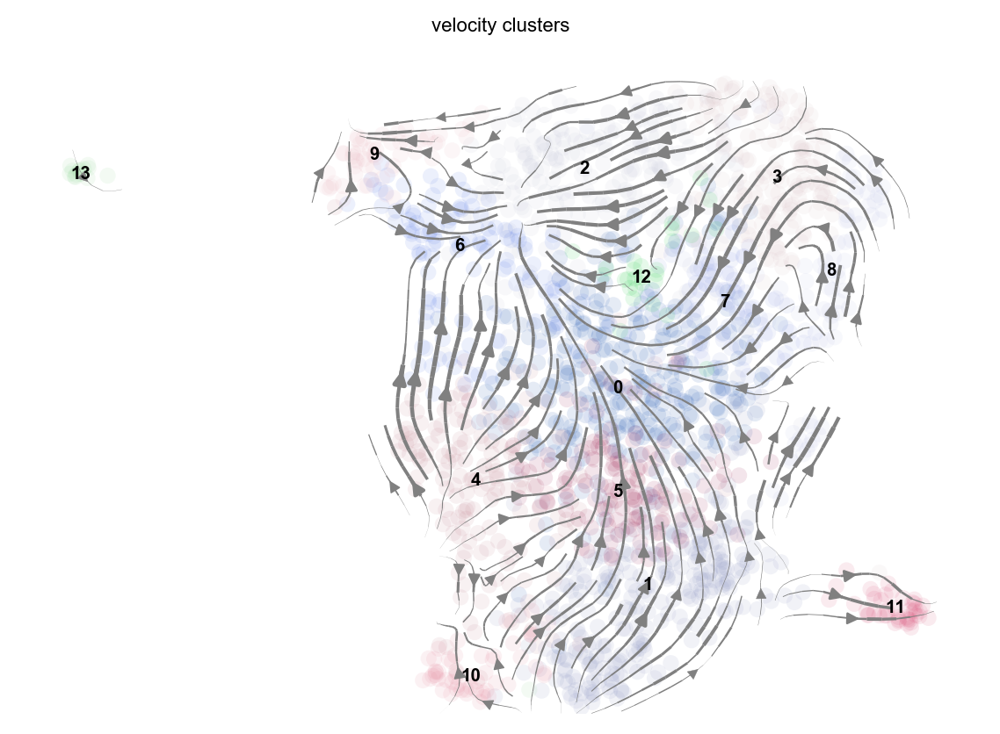

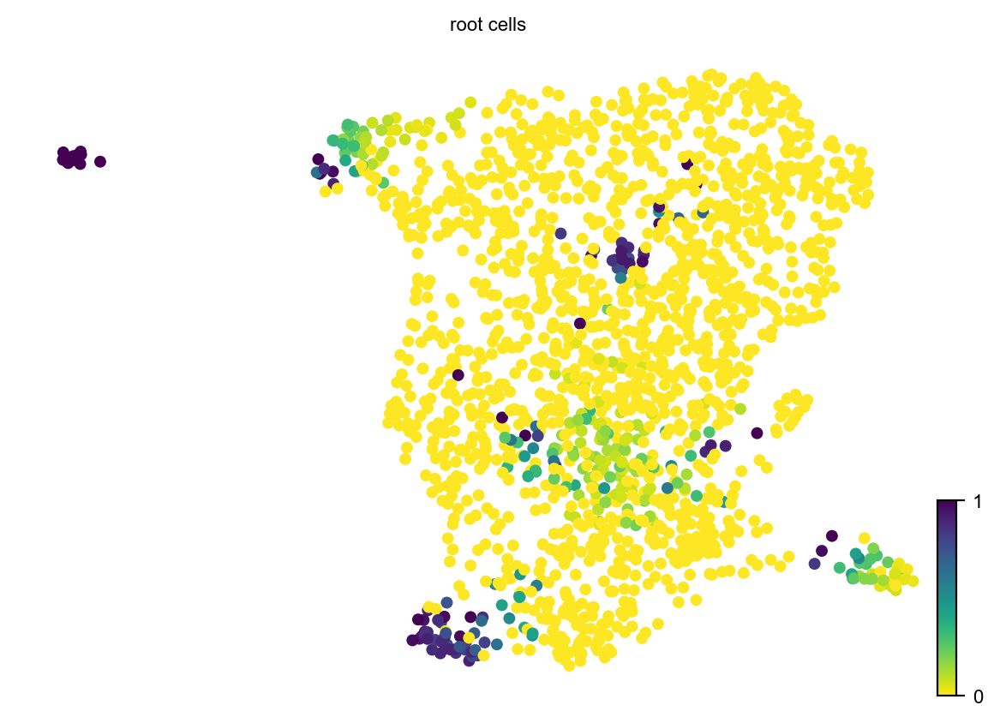

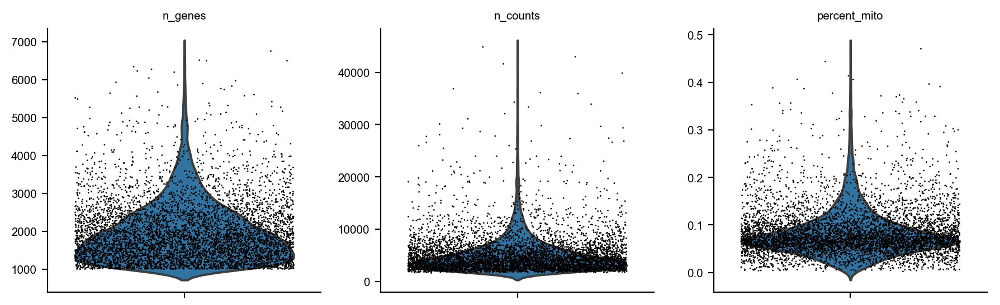

Trying to set attribute `.obs` of view, making a copy.


Filtered out 6878 genes that are detected in less than 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:07) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:01) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.


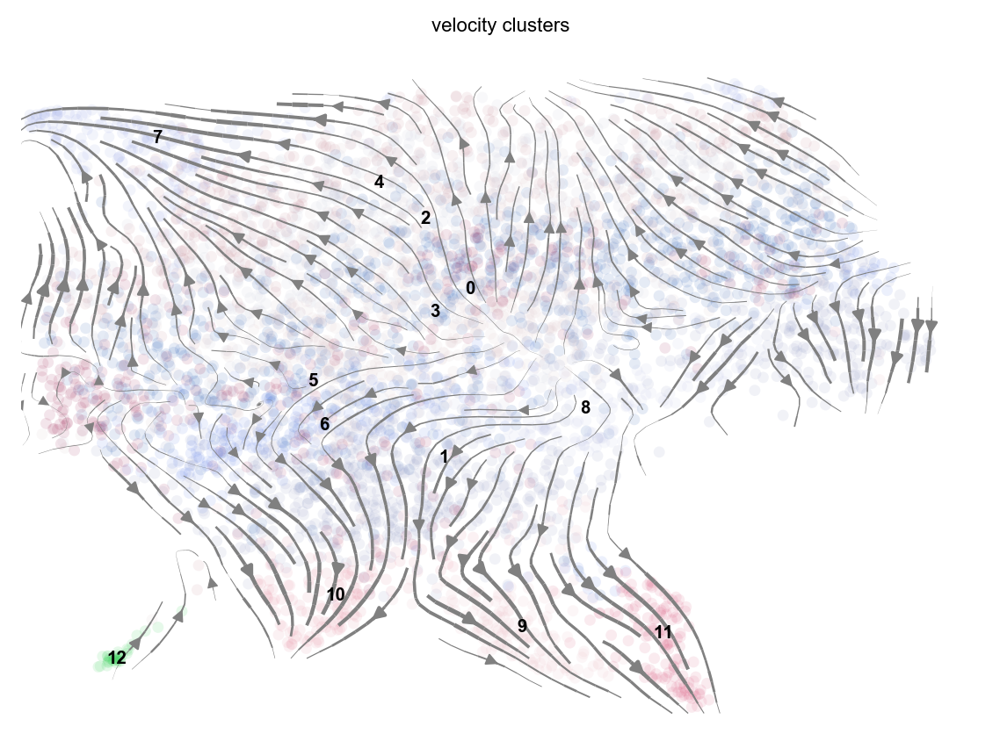

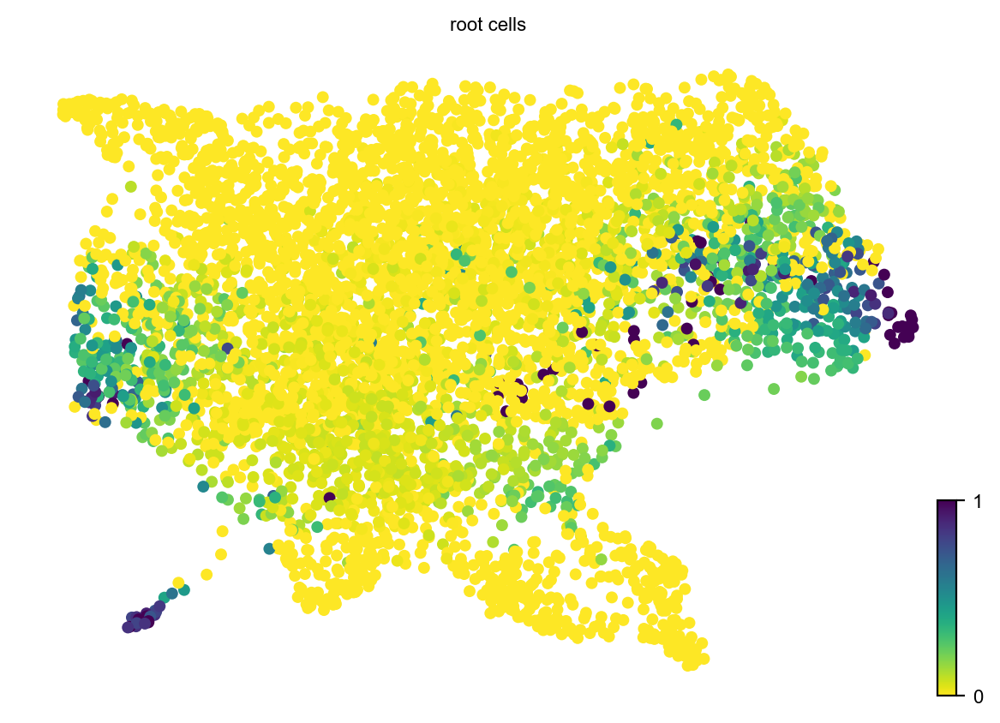

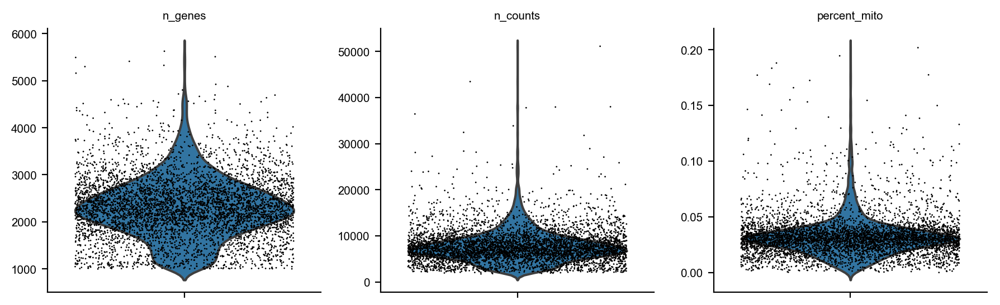

Trying to set attribute `.obs` of view, making a copy.


Filtered out 6731 genes that are detected in less than 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:04) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:01) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:01) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity 

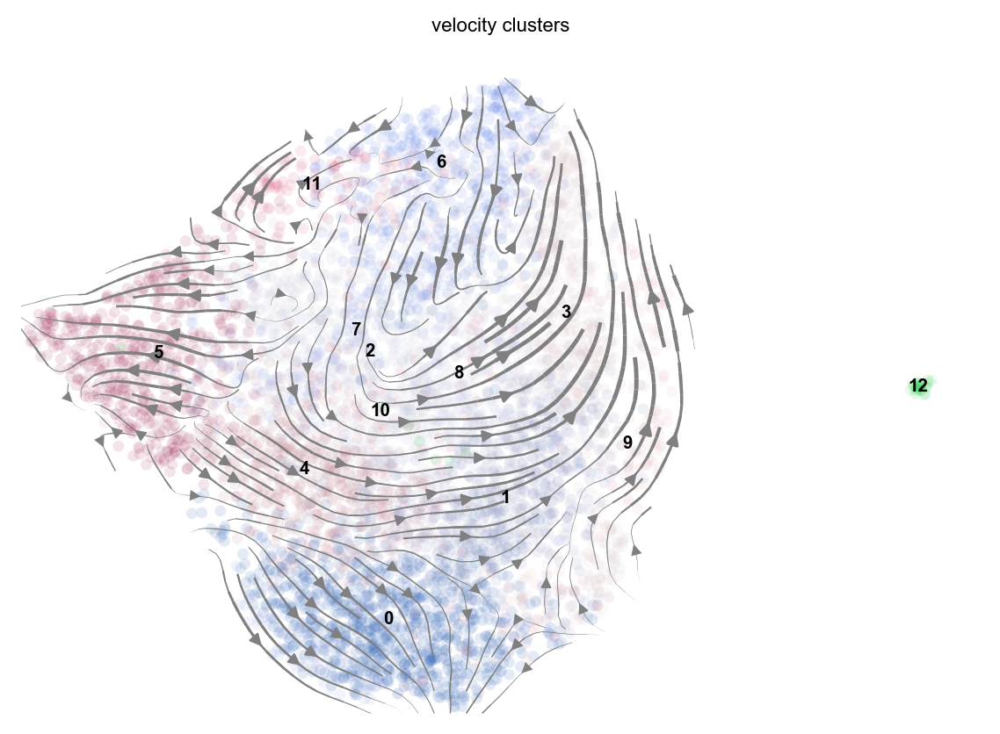

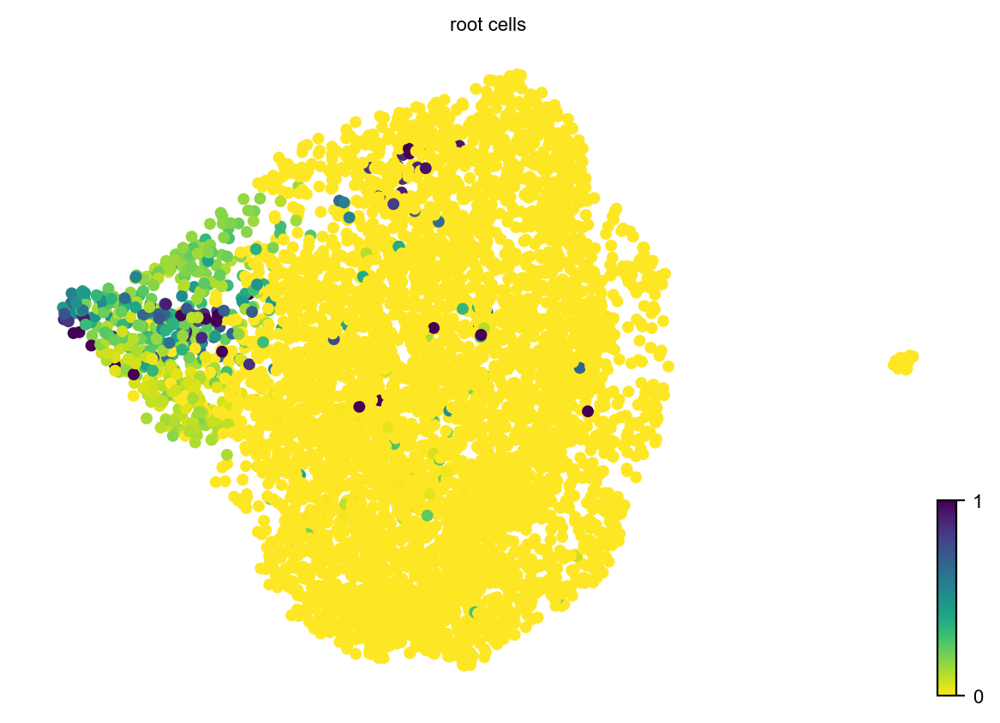

In [17]:
input_loom = {'mast111': '/data/langenau/alvin_singlecell/01_rms_projects/02_human/data/cellranger_counts/20190418_MAST111_5Kcells_hg19/velocyto/20190418_MAST111_5Kcells_hg19.loom',
              'mast139': '/data/langenau/alvin_singlecell/01_rms_projects/02_human/data/cellranger_counts/20190418_MAST139_5Kcells_hg19/velocyto/20190418_MAST139_5Kcells_hg19.loom',
              'rh74': '/data/langenau/alvin_singlecell/01_rms_projects/02_human/data/cellranger_counts/20190618_PDX1_RH74_5Kcells_hg19/velocyto/20190618_PDX1_RH74_5Kcells_hg19.loom'}
              
results_file = '../results/anndata/human/{}.h5ad'  # the file that will store the analysis results
!mkdir -p ../results/anndata/human/
for tumor in input_loom:
    adata = compute_velocity(input_loom[tumor], mito_prefix='MT-')
    adata.write(results_file.format(tumor))
    print(adata.obs.shape, len(adata.var_names))
    #plot_velocity(adata, 'FN1')
    ax1=scv.pl.velocity_embedding_stream(adata, basis='umap', color=['velocity_clusters'], show=False)
    ax2=scv.pl.scatter(adata, color=['root_cells'], size=100, show=False)

In [23]:
!ls /data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor21_zebrafish_with_orf_color_v2/velocyto/Tumor21_zebrafish_with_orf_color_v2.loom
!ls /data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor21_2ndlibrary_zebrafish/velocyto/Tumor21_2ndlibrary_zebrafish.loom

/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor21_zebrafish_with_orf_color_v2/velocyto/Tumor21_zebrafish_with_orf_color_v2.loom


Variable names are not unique. To make them unique, call `.var_names_make_unique`.


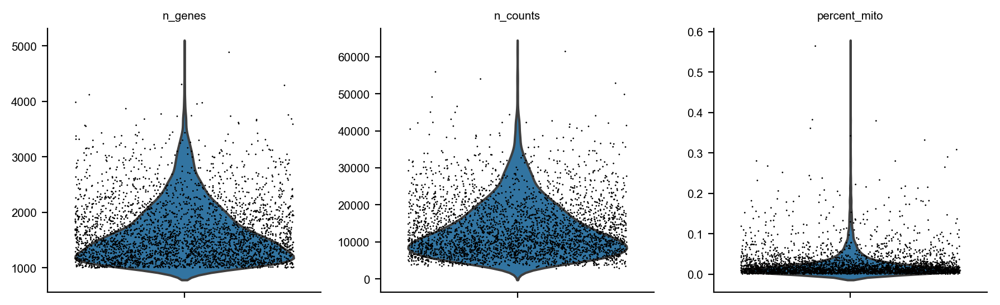

Trying to set attribute `.obs` of view, making a copy.


Filtered out 8721 genes that are detected in less than 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:07) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Making variable names unique for controlled concatenation.
... storing 'Chromosome-0' as categorical
... storing 'Strand' as categorical
... storing 'Chromosome-1' as categorical


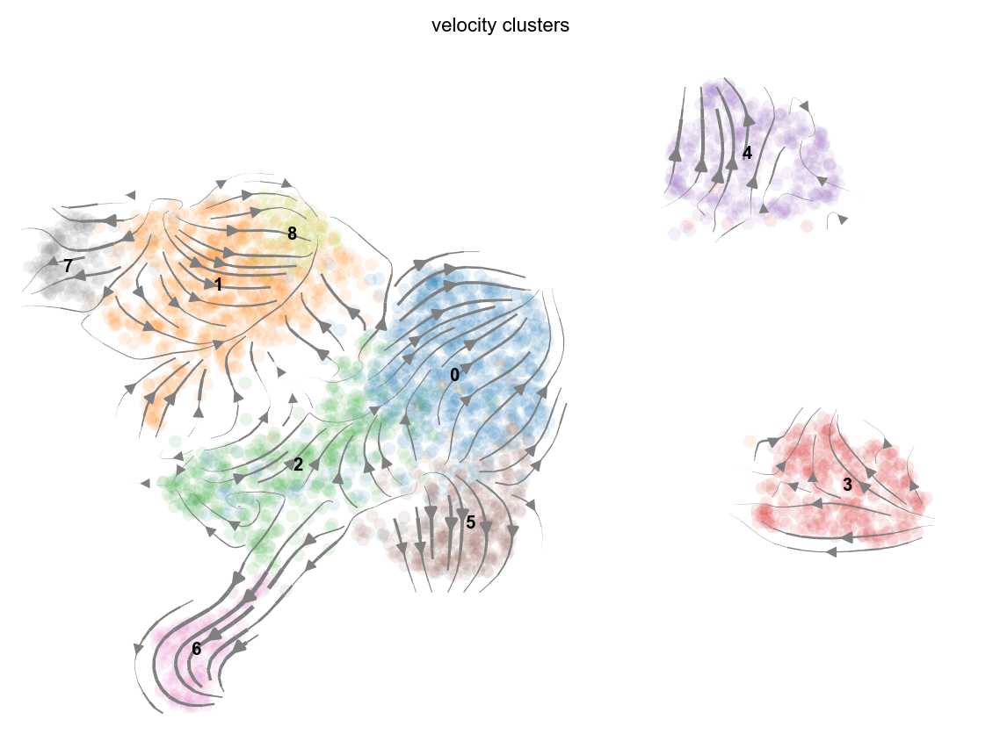

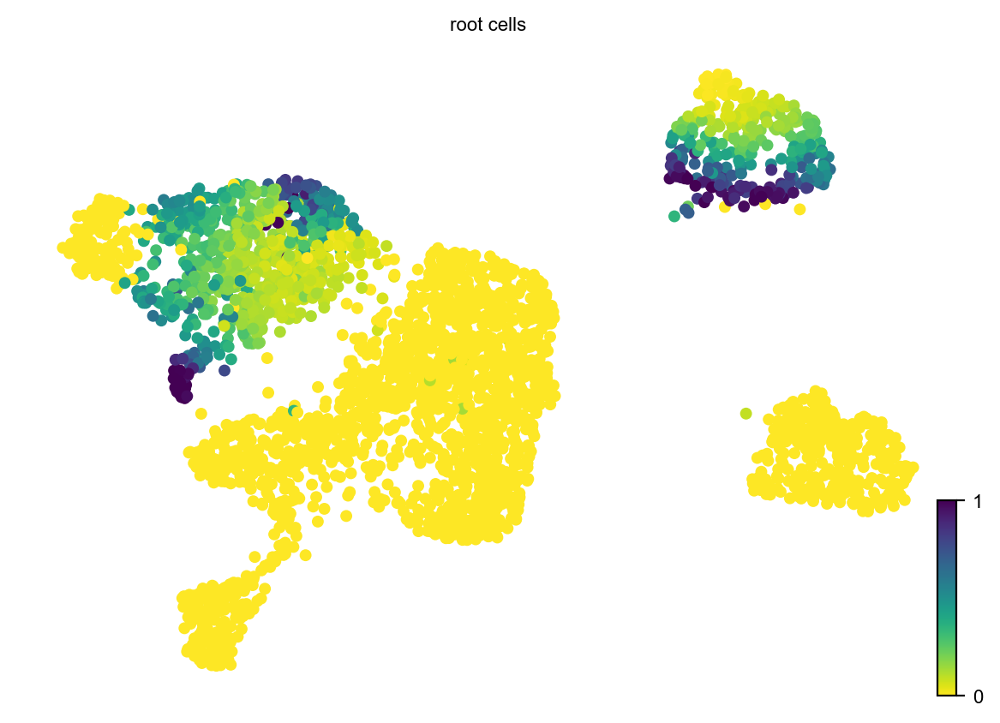

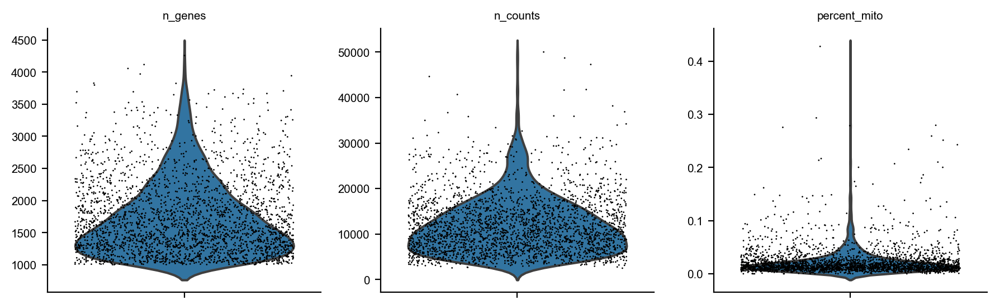

Trying to set attribute `.obs` of view, making a copy.


Filtered out 8475 genes that are detected in less than 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:05) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity 

Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Making variable names unique for controlled concatenation.
... storing 'Chromosome-0' as categorical
... storing 'Strand' as categorical
... storing 'Chromosome-1' as categorical


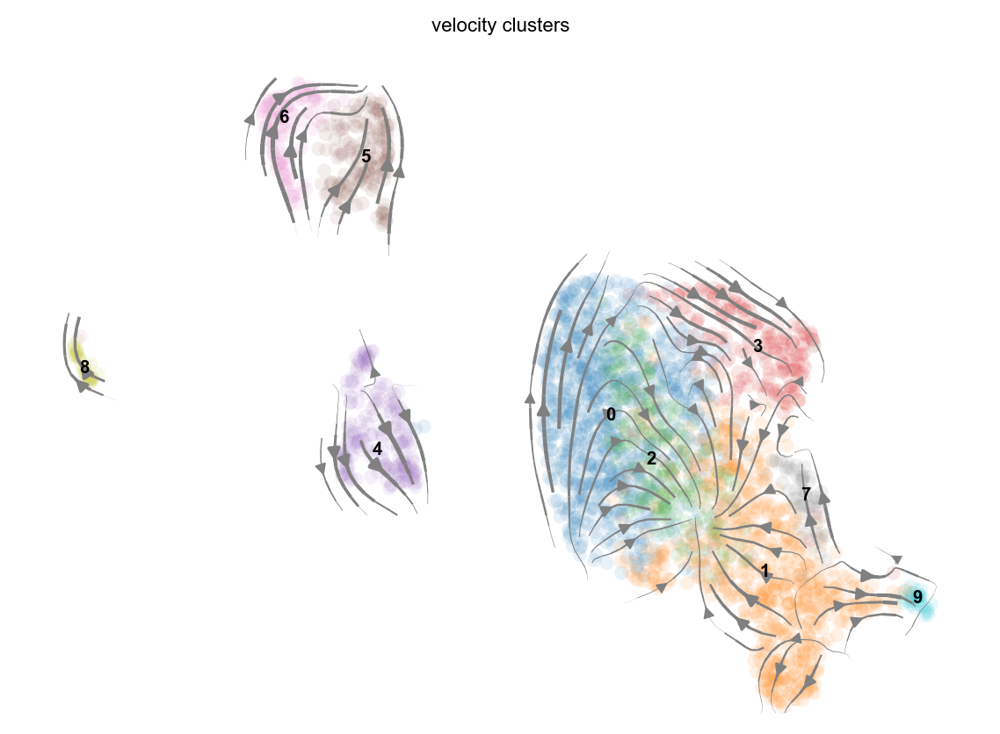

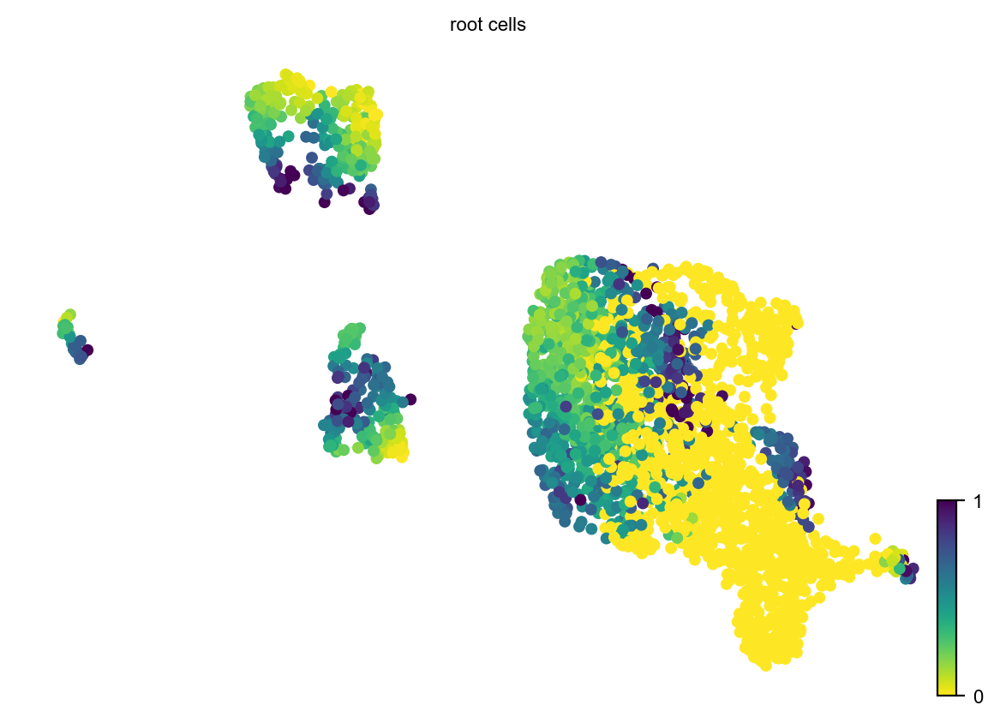

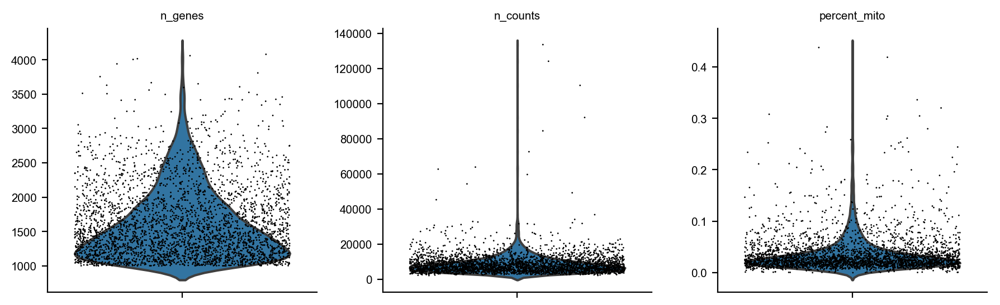

Trying to set attribute `.obs` of view, making a copy.


Filtered out 9116 genes that are detected in less than 10 counts (shared).
Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:00) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:01) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:06) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity 

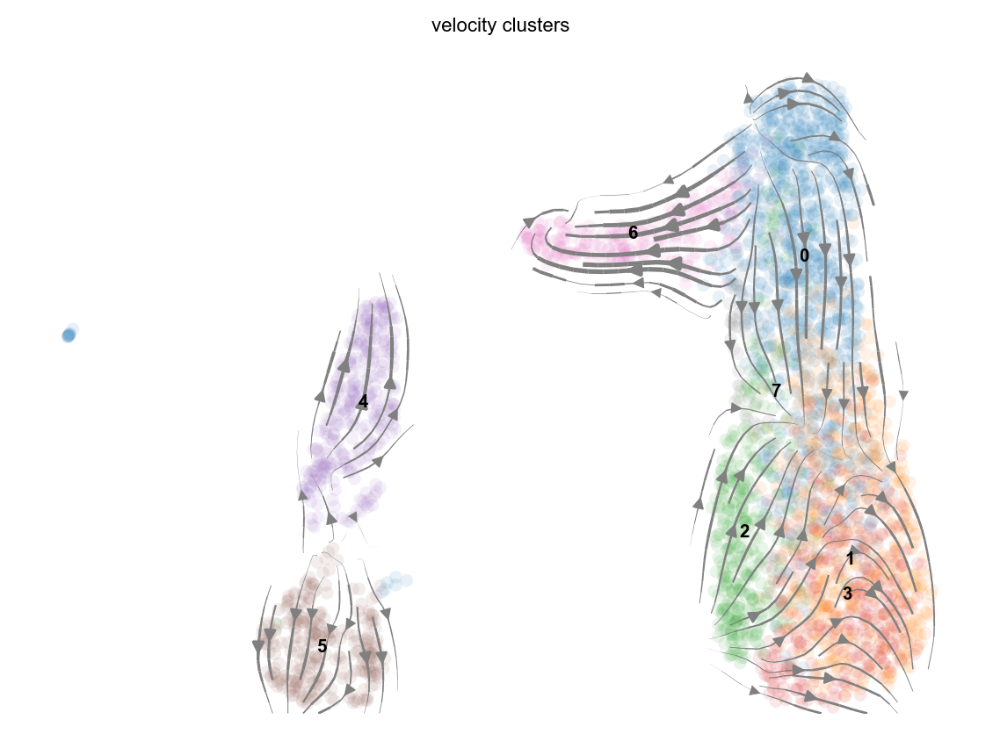

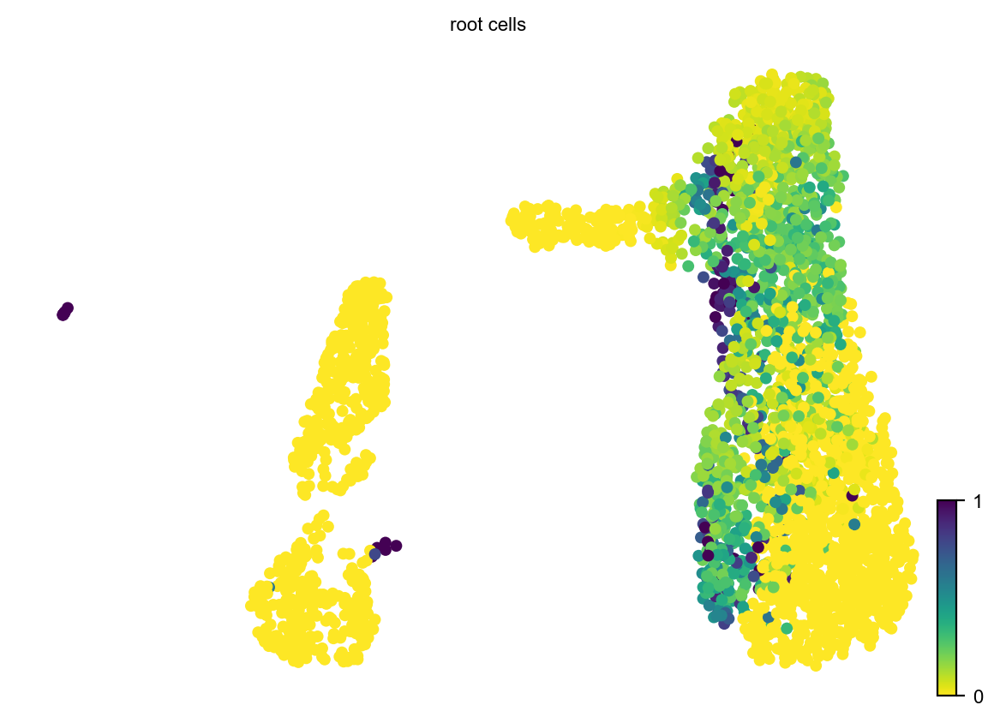

In [29]:
input_loom = {'tumor24': '/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor24_zebrafish_with_orf_color_v2/velocyto/Tumor24_zebrafish_with_orf_color_v2.loom',
              'tumor21': ['/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor21_zebrafish_with_orf_color_v2/velocyto/Tumor21_zebrafish_with_orf_color_v2.loom',
                          '/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor21_2ndlibrary_zebrafish/velocyto/Tumor21_2ndlibrary_zebrafish.loom'],
              'tumor22': ['/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor22_zebrafish_with_orf_color_v2/velocyto/Tumor22_zebrafish_with_orf_color_v2.loom',
                          '/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor22_2ndlibrary_zebrafish/velocyto/Tumor22_2ndlibrary_zebrafish.loom']}

results_file = '../results/anndata/zebrafish/{}.h5ad'  # the file that will store the analysis results
!mkdir -p ../results/anndata/zebrafish/
## zebrafishs
for tumor in input_loom:
    adata = compute_velocity(input_loom[tumor], mito_prefix='mt-', cutoff=[4000, 0.1])
    adata.write(results_file.format(tumor))
    print(adata.obs.shape, len(adata.var_names))
    #plot_velocity(adata, 'FN1')
    ax1=scv.pl.velocity_embedding_stream(adata, basis='umap', color=['velocity_clusters'], show=False)
    ax2=scv.pl.scatter(adata, color=['root_cells'], size=100, show=False)

Layers with keys: matrix, norm_data, scale_data, spliced, unspliced


... storing 'ClusterName' as categorical
... storing 'SCT_snn_res_0' as categorical
... storing 'SCT_snn_res_0_05' as categorical
... storing 'SCT_snn_res_0_1' as categorical
... storing 'SCT_snn_res_0_15' as categorical
... storing 'SCT_snn_res_0_2' as categorical
... storing 'SCT_snn_res_0_25' as categorical
... storing 'SCT_snn_res_0_3' as categorical
... storing 'SCT_snn_res_0_35' as categorical
... storing 'SCT_snn_res_0_4' as categorical
... storing 'SCT_snn_res_0_45' as categorical
... storing 'SCT_snn_res_0_5' as categorical
... storing 'SCT_snn_res_0_55' as categorical
... storing 'SCT_snn_res_0_6' as categorical
... storing 'SCT_snn_res_0_65' as categorical
... storing 'SCT_snn_res_0_7' as categorical
... storing 'SCT_snn_res_0_75' as categorical
... storing 'SCT_snn_res_0_8' as categorical
... storing 'SCT_snn_res_0_85' as categorical
... storing 'SCT_snn_res_0_9' as categorical
... storing 'SCT_snn_res_0_95' as categorical
... storing 'SCT_snn_res_1' as categorical
... stor

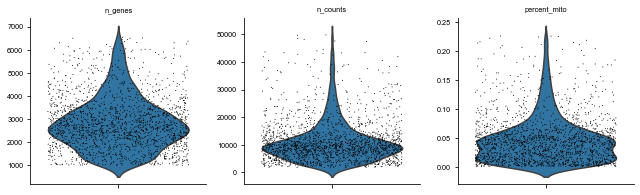

Trying to set attribute `.obs` of view, making a copy.


Normalized count data: X, spliced, unspliced.
Logarithmized X.
computing neighbors
    finished (0:00:02) --> added to `.uns['neighbors']`
    'distances', weighted adjacency matrix
    'connectivities', weighted adjacency matrix
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of spliced/unspliced abundances (adata.layers)
computing velocities
    finished (0:00:00) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:00:01) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
computing velocity clusters
    finished (0:00:00) --> added 
    'velocity_clusters', clusters based on modularity on velocity field (adata.obs)
ranking velocity genes
    finished (0:00:00) --> added 
    'rank_velocity_genes', sorted s

In [3]:
test = compute_velocity('/data/langenau/alvin_singlecell/01_rms_projects/01_fish/results/seurat_intersect_velocity/20190624_seurat-object_MAST111_vel.loom',
                        mito_prefix='MT-', cutoff=[4000, 0.1],
                        norm=False)

In [4]:
test_seu = robjects.r('readRDS')('../results/seurat_intersect_velocity/20190624_seurat-object_MAST111_seu.rds')

In [5]:
from rpy2.robjects import r, pandas2ri
pandas2ri.activate()
meta = pandas2ri.ri2py(test_seu.slots['meta.data'])
clusters = meta.loc[test[1], 'RNA_snn_res.0.8']
reductions = pandas2ri.ri2py(r['data.frame'](r['slot'](test_seu.slots['reductions'].rx2('umap'), 'cell.embeddings')))

In [6]:
test[0].obsm['X_umap'].shape

(1481, 2)

In [7]:
test[0].obsm['X_umap']  = reductions.loc[test[1], :].values
test[0].obs['clusters'] = clusters.values
test[0].obs['louvain'] = clusters.values

In [9]:
?sc.pl.paga

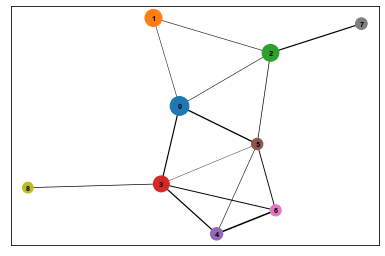

In [8]:
sc.tl.paga(test[0])
sc.pl.paga(test[0], edge_width_scale=0.2, threshold=0.2)

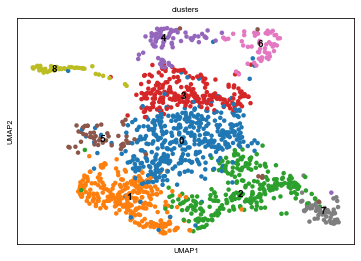

In [15]:
ax=sc.pl.umap(test[0], color=['clusters'], legend_loc='on data',show=False)

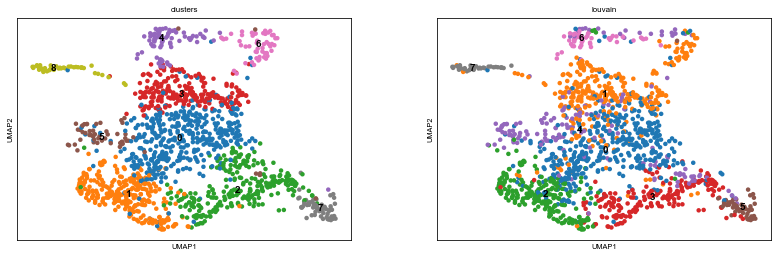

In [22]:
sc.tl.diffmap(test[0])
sc.pp.neighbors(test[0], n_neighbors=15, use_rep='X_diffmap')
sc.tl.louvain(test[0], resolution=0.2)
sc.pl.umap(test[0], color=['clusters', 'louvain'], legend_loc='on data')

In [23]:
sc.tl.paga(test[0], groups='clusters', use_rna_velocity=False)

In [28]:
test[0]

AnnData object with n_obs × n_vars = 1481 × 3000 
    obs: 'ClusterID', 'ClusterName', 'SCT_snn_res_0', 'SCT_snn_res_0_05', 'SCT_snn_res_0_1', 'SCT_snn_res_0_15', 'SCT_snn_res_0_2', 'SCT_snn_res_0_25', 'SCT_snn_res_0_3', 'SCT_snn_res_0_35', 'SCT_snn_res_0_4', 'SCT_snn_res_0_45', 'SCT_snn_res_0_5', 'SCT_snn_res_0_55', 'SCT_snn_res_0_6', 'SCT_snn_res_0_65', 'SCT_snn_res_0_7', 'SCT_snn_res_0_75', 'SCT_snn_res_0_8', 'SCT_snn_res_0_85', 'SCT_snn_res_0_9', 'SCT_snn_res_0_95', 'SCT_snn_res_1', 'SCT_snn_res_1_05', 'SCT_snn_res_1_1', 'SCT_snn_res_1_15', 'SCT_snn_res_1_2', 'SCT_snn_res_1_25', 'SCT_snn_res_1_3', 'SCT_snn_res_1_35', 'SCT_snn_res_1_4', 'SCT_snn_res_1_45', 'SCT_snn_res_1_5', 'SCT_snn_res_1_55', 'SCT_snn_res_1_6', 'SCT_snn_res_1_65', 'SCT_snn_res_1_7', 'SCT_snn_res_1_75', 'SCT_snn_res_1_8', 'SCT_snn_res_1_85', 'SCT_snn_res_1_9', 'SCT_snn_res_1_95', 'SCT_snn_res_2', 'nCount_SCT', 'nCount_ambiguous', 'nCount_spliced', 'nCount_unspliced', 'nFeature_SCT', 'nFeature_ambiguous', 'nFeature_

In [91]:
pos = test[0].obsm['X_umap']
red = reductions.loc[test[1], :]
pos_raw = []
for i in sorted(clusters.unique()):
    redt = red.loc[(clusters==i), :]
    print(redt.median(axis=0))
    pos_raw.append(redt.median(axis=0).values)
pos = np.vstack(pos_raw)

UMAP_1   -2.067799
UMAP_2   -1.164400
dtype: float64
UMAP_1   -3.669229
UMAP_2   -4.768091
dtype: float64
UMAP_1   -0.230198
UMAP_2   -4.539468
dtype: float64
UMAP_1   -1.989626
UMAP_2    1.701542
dtype: float64
UMAP_1   -2.613686
UMAP_2    5.369303
dtype: float64
UMAP_1   -4.513724
UMAP_2   -1.050922
dtype: float64
UMAP_1    0.397812
UMAP_2    4.982465
dtype: float64
UMAP_1    2.361084
UMAP_2   -5.661605
dtype: float64
UMAP_1   -5.992656
UMAP_2    3.428002
dtype: float64


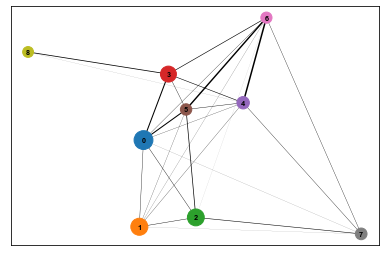

In [27]:
sc.pl.paga(test[0], threshold=0.02, edge_width_scale=0.2, layout='fr', pos=pos)
# sc.tl.umap(test[0], init_pos='paga')

In [29]:
metalabels = np.array(["GROUND", "Hypoxia", "EMT", 
                       "G1S", "UNASSIGNED", "G2M", 
                       "MUSCLE", "INTERFERON", "PROLIF", "Histones"])

In [30]:
metacolors = np.array(["#A6A6A6", "#F19545", "#672366", "#3465FC", "#F2F2F2",
              "#3465FC", "#E93F33", "#418107", "#3465FC", "#FDF731"])
label = 'MAST111'

In [31]:
colortab = pd.read_table('color_table.xls')

In [33]:
metacolors[pd.match(colortab.loc[:, label].dropna(), metalabels)]

array(['#A6A6A6', '#F19545', '#672366', '#A6A6A6', '#3465FC', '#F2F2F2',
       '#3465FC', '#672366', '#E93F33'], dtype='<U7')

In [88]:
test[0].uns.keys()

odict_keys(['pca', 'neighbors', 'louvain', 'velocity_settings', 'velocity_graph', 'velocity_graph_neg', 'rank_velocity_genes', 'paga', 'louvain_sizes', 'louvain_colors', 'clusters_colors', 'diffmap_evals', 'clusters_sizes', 'label_color', 'workdir', 'trans_mlle', 'epg', 'flat_tree', 'seed_epg', 'seed_flat_tree', 'ori_epg', 'epg_obj', 'ori_epg_obj', 'subwaymap_S1'])

In [34]:
test[0].uns['clusters_colors'] = metacolors[pd.match(colortab.loc[:, label].dropna(), metalabels)]
test[0].obs['clusters'].cat.categories = np.array([str(i) + '_' +colortab.loc[:, label].dropna()[i] for i in range(len(colortab.loc[:, label].dropna()))])

In [83]:
# scv.pl.scatter(test[0], color=['velocity_pseudotime', 'root_cells', 'end_points'], size=200)

In [84]:
?scv.pl.scatter

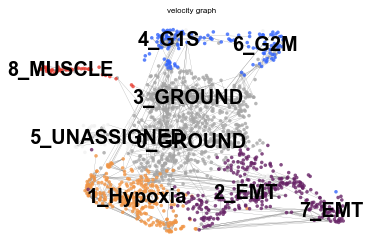

In [81]:
scv.pl.velocity_graph(test[0], legend_fontsize=20)

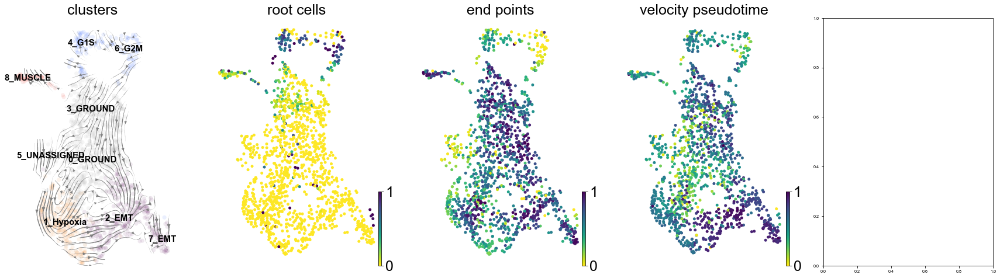

In [43]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(1, 5)
fig.set_size_inches(30, 7.5)
ax=scv.pl.velocity_embedding_stream(test[0], basis='umap', color=['clusters'], 
                                    legend_fontsize=15, show=False, ax=axes[0])
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(25)
ax2=scv.pl.scatter(test[0], color=['root_cells'], size=100, show=False, ax=axes[1])
ax3=scv.pl.scatter(test[0], color=['end_points'], size=100, show=False, ax=axes[2])
ax3=scv.pl.scatter(test[0], color=['velocity_pseudotime'], size=100, ax=axes[3])
ax4=sc.pl.paga(test[0], color=['clusters'], edge_width_scale=0.5, layout='fr', random_state=0, frameon=False,
               fontsize=16, threshold=0.2, ax=axes[4], pos=pos)
plt.rcParams.update({'font.size': 25})

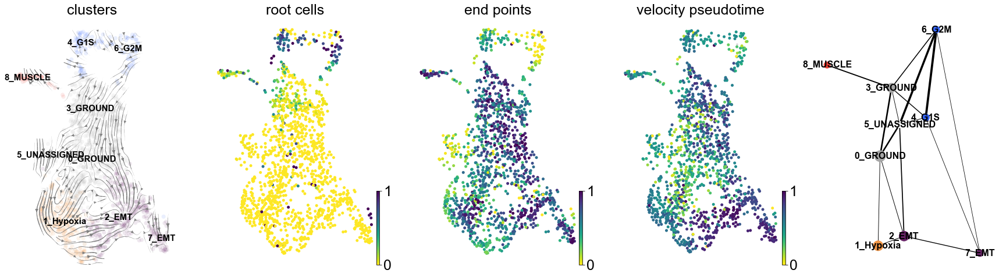

In [44]:
fig

In [39]:
pd.DataFrame(test.uns['rank_velocity_genes']['names'])

,0,1,2,3,4,5,6,7,8,9,10,11
0,cox8b,si:ch211-195m9.3,msra,ca10a,htr4,rbfox3a,trim105,notch1a,fam13b,pfkpa,macf1a,egfra
1,eno1a,spred2b,lrp1ab,il15,fbln1,lama5,col6a3,oaz2a,luzp2,slc16a9a,wfdc2,BX663516.2
2,aldocb,rnf220a,wu:fj16a03,hs6st1a,hmcn1,gpc1b,si:ch211-198c19.3,bcam,tlx2,mknk2b,jam3b,LO017815.1
3,hif1an,fam13b,si:ch211-132b12.7,plekhg5a,rnf220a,tp53i11b,LO017815.1,abcc9,prkcsh,grb10b,wif1,crip1
4,plpp3,prex2,fosl2,cyp46a1.2,ptprz1b,abhd3,lifrb,slc12a7b,si:dkey-261h17.1,lima1a,lama5,mmp14a
5,pmp22b,prkcsh,ctsk,ptprz1b,cspg5a,ntn1a,BX663516.2,gpc5c,kirrel3l,hbegfa,hsp90aa1.1,c6.1
6,ldha,nrg1,fbln1,ntf3,chd6,CT573344.1,asap3,tp63,matr3l1.1.1,vps13a,CT573344.1,acsl3b
7,grb10b,mllt3,il15,tp53i11b,zgc:92161,scn4ab,antxr2a,palld,met,s100a10b,cdh13,postna
8,lima1a,arhgef1b,zgc:92161,wfdc2,angptl2a,cabp2b,fam102ab,ppfia4,antxr2a,si:dkey-205h13.1,myf5,si:ch73-86n18.1
9,gapdhs,fgfr3,zbtb16b,sesn1,edil3a,ect2,mmp14a,KIF1C,sulf1,c4b,ryr1b,thbs2b


In [46]:
# input_loom = {'tumor24': '/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor24_zebrafish_with_orf_color_v2/velocyto/Tumor24_zebrafish_with_orf_color_v2.loom',
#               'tumor21': ['/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor21_zebrafish_with_orf_color_v2/velocyto/Tumor21_zebrafish_with_orf_color_v2.loom',
#                           '/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor21_2ndlibrary_zebrafish/velocyto/Tumor21_2ndlibrary_zebrafish.loom'],
#               'tumor22': ['/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor22_zebrafish_with_orf_color_v2/velocyto/Tumor22_zebrafish_with_orf_color_v2.loom',
#                           '/data/langenau/alvin_singlecell/01_rms_projects/01_fish/data/cellranger_counts/Tumor22_2ndlibrary_zebrafish/velocyto/Tumor22_2ndlibrary_zebrafish.loom']}

# results_file = '../results/anndata/zebrafish/{}.h5ad'  # the file that will store the analysis results
# !mkdir -p ../results/anndata/zebrafish/
# ## zebrafishs
# for tumor in input_loom:
#     adata = compute_velocity(input_loom[tumor], mito_prefix='mt-', cutoff=[4000, 0.1])
#     adata.write(results_file.format(tumor))
#     print(adata.obs.shape, len(adata.var_names))
#     #plot_velocity(adata, 'FN1')
#     ax1=scv.pl.velocity_embedding_stream(adata, basis='umap', color=['velocity_clusters'], show=False)
#     ax2=scv.pl.scatter(adata, color=['root_cells'], size=100, show=False)

## Stream analysis 

In [66]:
test[0].obs['label']=test[0].obs['clusters']
st.add_cell_colors(test[0])

No cell color file is provided, random color is generated for each cell label


In [67]:
updated_colors = {}
for col, cat in zip(test[0].uns['clusters_colors'], test[0].obs['clusters'].cat.categories):
    updated_colors[cat] = col
test[0].uns['label_color'] = updated_colors

In [68]:
test[0].obsm

AxisArrays with keys: pca_cell_embeddings, tsne_cell_embeddings, umap_cell_embeddings, X_pca, X_umap, velocity_umap, X_diffmap, X_dr, X_vis_umap, top_pcs, X_mlle, X_subwaymap_S1

In [69]:
# adata.obsm['top_pcs'] = adata.obsm['umap_cell_embeddings']
test[0].obsm['X_dr'] = test[0].obsm['X_pca'] ###velocity_umap
test[0].uns['workdir'] = 'test'
test[0].obsm['X_pca'].shape

(1481, 20)

In [70]:
test[0].obsm['X_vis_umap'] = test[0].obsm['X_umap']
test[0].obsm['top_pcs'] = test[0].obsm['X_pca']
test[0].obsm['top_pcs'].shape

(1481, 20)

In [52]:
st.dimension_reduction(test[0], feature='top_pcs') # method='se', 

feature top_pcs is being used ...
44 cpus are being used ...


In [71]:
# learning epigraph
!mkdir -p test
st.seed_elastic_principal_graph(test[0])
st.elastic_principal_graph(test[0])
#st.optimize_branching(test[0])
# st.prune_elastic_principal_graph(adata)
# st.shift_branching(adata)
# st.extend_elastic_principal_graph(adata)

Seeding initial elastic principal graph...
Clustering...
K-Means clustering ...
The number of initial nodes is 10
Calculatng minimum spanning tree...
Number of initial branches: 8
Learning elastic principal graph...
[1]
 "Constructing tree 1 of 1 / Subset 1 of 1"


[1]
 "Computing EPG with 50 nodes on 1481 points and 20 dimensions"


[1]
 "Using a single core"


Nodes = 
10
 
11
 
12
 
13
 
14
 
15
 
16
 
17
 
18
 
19
 
20
 
21
 
22
 
23
 
24
 
25
 
26
 
27
 
28
 
29
 
30
 
31
 
32
 
33
 
34
 
35
 
36
 
37
 
38
 
39
 
40
 
41
 
42
 
43
 
44
 
45
 
46
 
47
 
48
 
49
 


BARCODE	ENERGY	NNODES	NEDGES	NRIBS	NSTARS	NRAYS	NRAYS2	MSE	MSEP	FVE	FVEP	UE	UR	URN	URN2	URSD

5||50
	
37.81
	
50
	
49
	
38
	
5
	
0
	
0
	
33.9
	
33.75
	
0.6106
	
0.6123
	
3.027
	
0.8778
	
43.89
	
2194
	
0


56.216 sec elapsed

[[1]]



Number of branches after learning elastic principal graph: 11


In [72]:
test[0].obs.head()

,ClusterID,ClusterName,SCT_snn_res_0,SCT_snn_res_0_05,SCT_snn_res_0_1,SCT_snn_res_0_15,SCT_snn_res_0_2,SCT_snn_res_0_25,SCT_snn_res_0_3,SCT_snn_res_0_35,...,S7_pseudotime,S3_pseudotime,S11_pseudotime,S5_pseudotime,S6_pseudotime,S2_pseudotime,S4_pseudotime,S1_pseudotime,S8_pseudotime,S10_pseudotime
20190418_MAST111_5Kcells_hg19:AAACCCAAGCGAGGAGx,6,5,0,0,0,1,1,1,1,4,...,9.854771,17.745830,17.283390,11.548504,15.459824,25.849798,32.034542,20.021216,25.877046,13.199102
20190418_MAST111_5Kcells_hg19:AAACGCTAGAGAGCGGx,2,1,0,0,0,0,0,0,1,1,...,4.672610,12.563668,15.151249,6.366342,10.277663,20.667637,26.852381,14.839055,11.349665,27.726482
20190418_MAST111_5Kcells_hg19:AAACGCTGTTCGATTGx,4,3,0,0,2,3,3,3,3,3,...,18.384776,26.275834,25.813395,20.078509,23.989829,34.379803,40.564547,28.551221,34.407051,4.669097
20190418_MAST111_5Kcells_hg19:AAACGCTTCTGGTGCGx,2,1,0,0,0,0,0,0,1,1,...,2.794765,10.685823,13.273404,4.488497,8.399818,18.789792,24.974536,12.961210,13.227510,25.848637
20190418_MAST111_5Kcells_hg19:AAAGAACAGTGTTGTCx,2,1,0,0,0,0,0,1,1,1,...,8.668727,16.559785,19.147365,10.362459,14.273779,24.663754,30.848497,18.835171,7.353549,31.722599


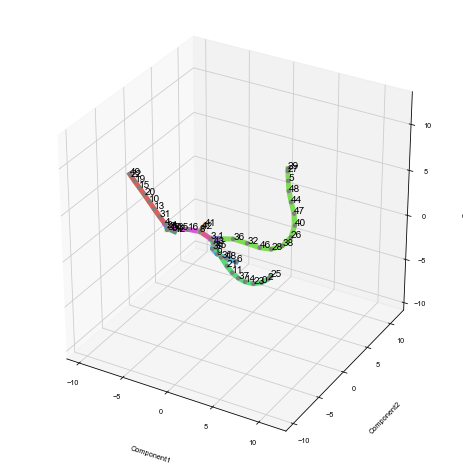

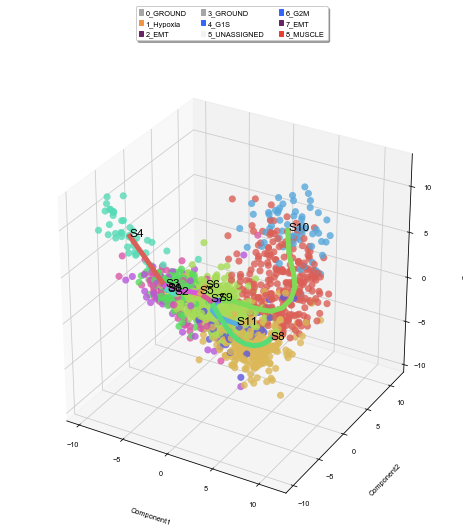

In [73]:
# st.plot_flat_tree(test)
st.plot_branches(test[0])
st.plot_branches_with_cells(test[0])

Importing precomputed umap visualization ...
Importing precomputed umap visualization ...


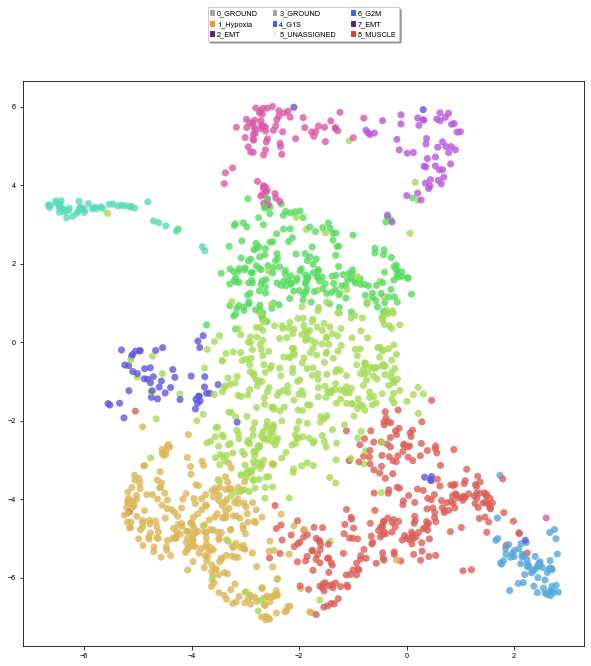

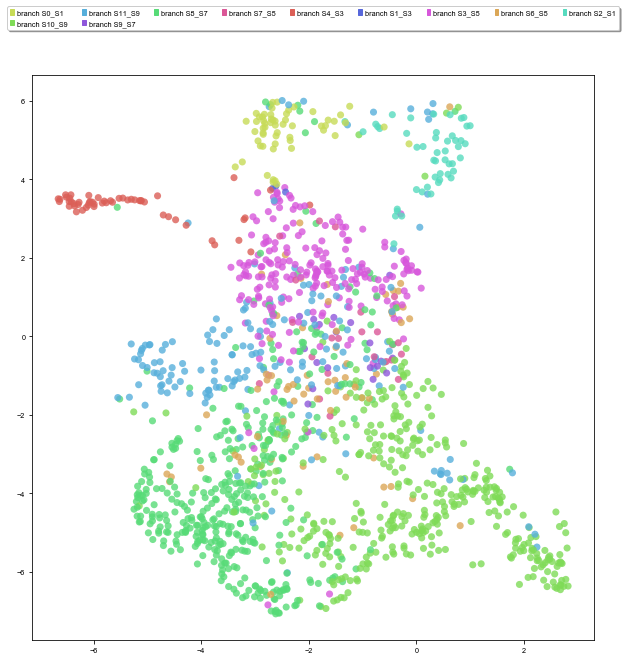

In [74]:
st.plot_visualization_2D(test[0])
st.plot_visualization_2D(test[0],color_by='branch',fig_legend_ncol=9)

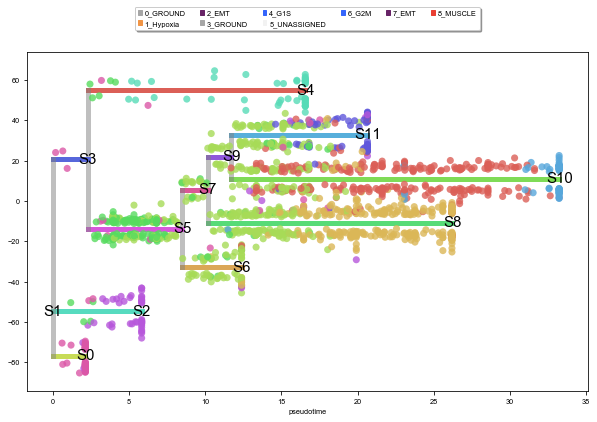

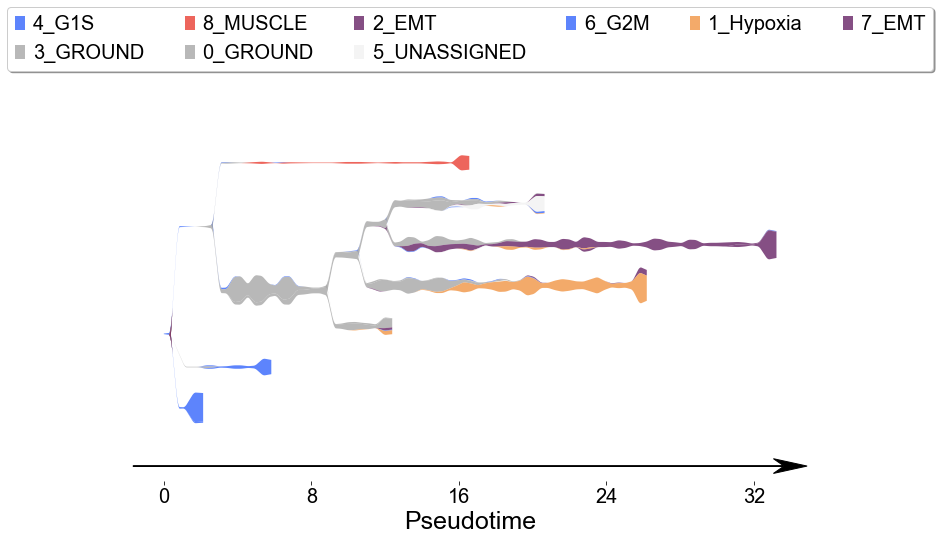

In [77]:
st.subwaymap_plot(test[0], root='S1', fig_legend_ncol=6) 
st.stream_plot(test[0], root='S1',fig_legend_ncol=6)

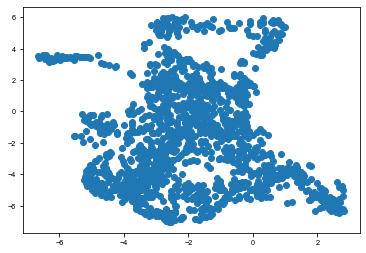

In [57]:
plt.scatter(test[0].obsm['X_umap'][:, 0], test[0].obsm['X_umap'][:, 1])

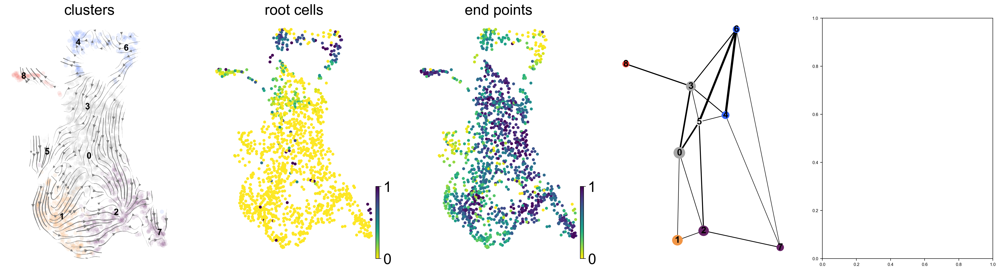

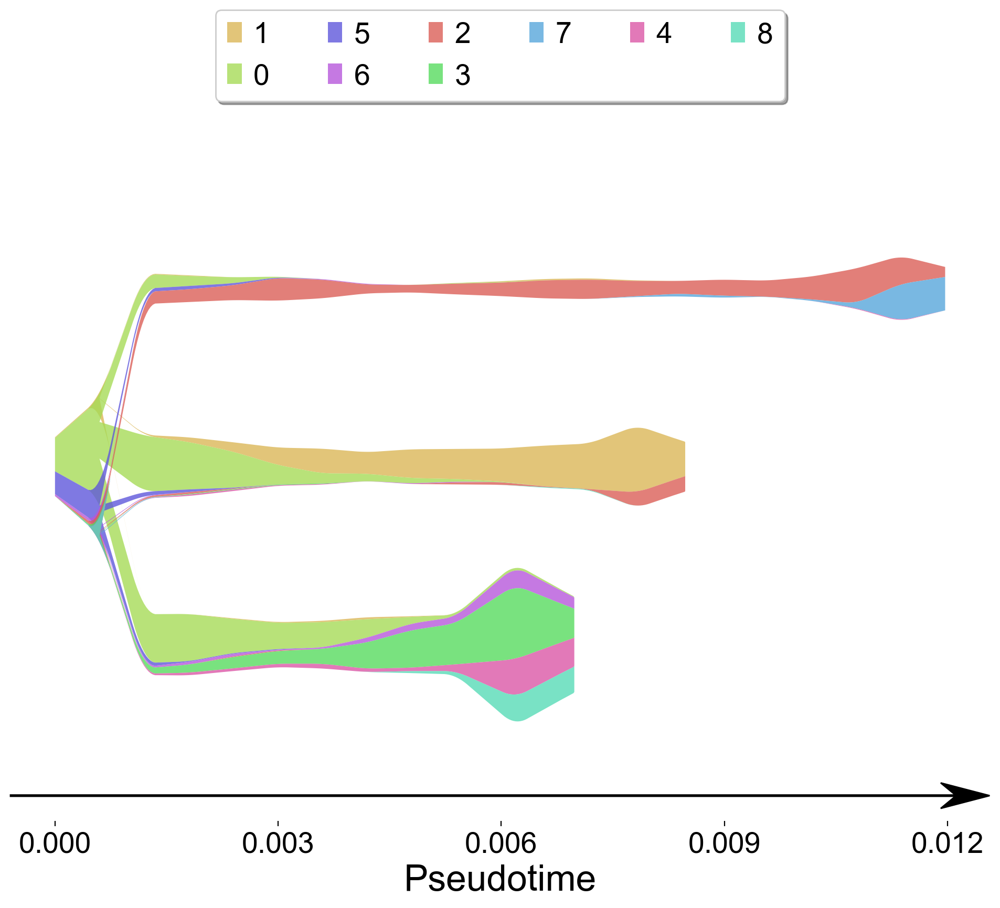

In [463]:
import matplotlib.pyplot as plt
fig, axes = plt.subplots(1, 5)
fig.set_size_inches(30, 7.5)
ax=scv.pl.velocity_embedding_stream(test[0], basis='umap', color=['clusters'], 
                                    legend_fontsize=15, show=False, ax=axes[0])
for item in ([ax.title, ax.xaxis.label, ax.yaxis.label] +
             ax.get_xticklabels() + ax.get_yticklabels()):
    item.set_fontsize(25)
ax2=scv.pl.scatter(test[0], color=['root_cells'], size=100, show=False, ax=axes[1])
ax3=scv.pl.scatter(test[0], color=['end_points'], size=100, show=False, ax=axes[2])
ax4=sc.pl.paga(test[0], color=['clusters'], edge_width_scale=0.5, layout='fr', random_state=0, frameon=False,
               fontsize=16, threshold=0.2, ax=axes[3], pos=pos)
st.stream_plot(test[0], root='S1',fig_legend_ncol=6) 
plt.rcParams.update({'font.size': 25})

# Original velocity analysis

In [66]:
vlm = vcy.VelocytoLoom('/data/langenau/alvin_singlecell/01_rms_projects/02_human/data/cellranger_counts/20190418_MAST139_5Kcells_hg19/velocyto/20190418_MAST139_5Kcells_hg19.loom')
vlm.filter_cells(bool_array=(vlm.initial_Ucell_size>np.percentile(vlm.initial_Ucell_size, 0.5)))

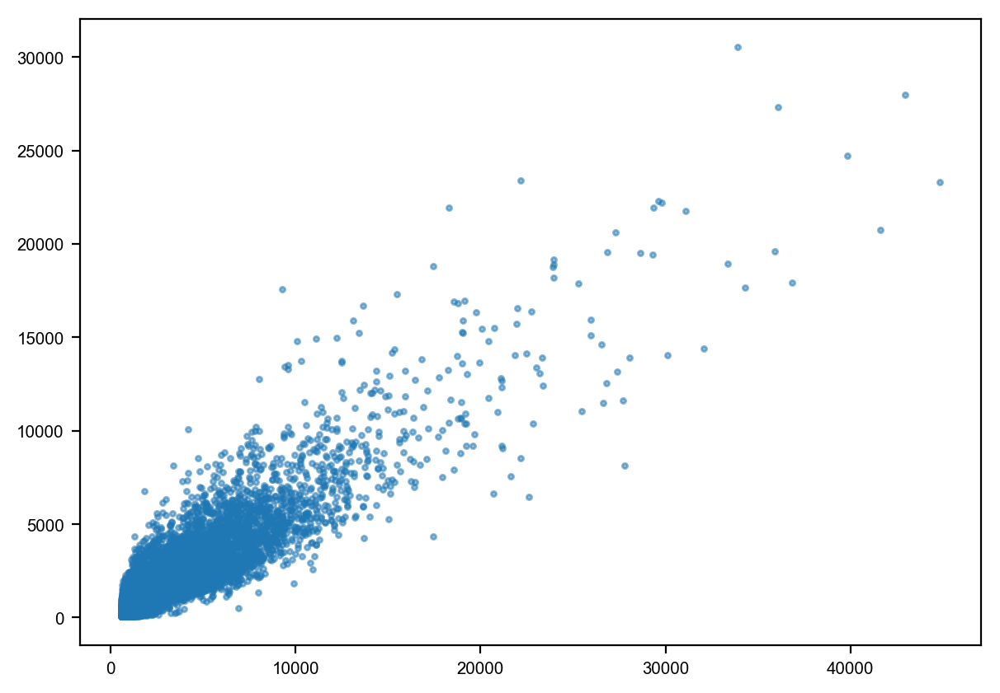

In [68]:
import matplotlib.pyplot as plt
plt.scatter(vlm.initial_cell_size, vlm.initial_Ucell_size, alpha=0.5, s=5)

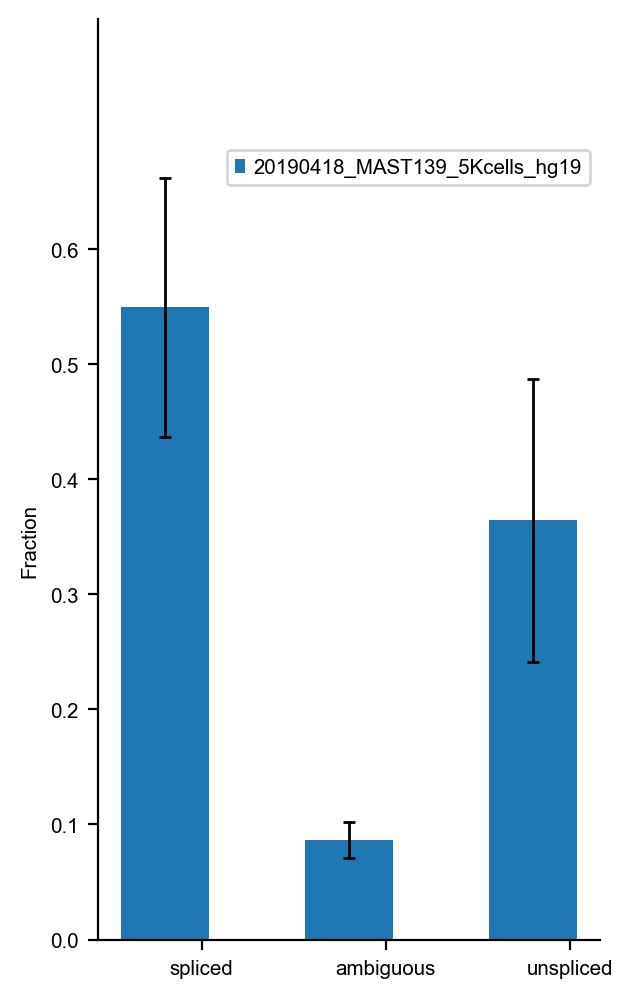

In [69]:
vlm.plot_fractions()

In [72]:
vlm.set_clusters(vlm.ca['Clusters'])

In [75]:
vlm.score_detection_levels(min_expr_counts=40, min_cells_express=30)
vlm.filter_genes(by_detection_levels=True)

vlm.score_cv_vs_mean(3000, plot=True, max_expr_avg=35)
vlm.filter_genes(by_cv_vs_mean=True)

In [76]:
vlm._normalize_S(relative_size=vlm.S.sum(0),
             target_size=vlm.S.sum(0).mean())
vlm._normalize_U(relative_size=vlm.U.sum(0),
             target_size=vlm.U.sum(0).mean())

In [77]:
vlm.perform_PCA()
k = 500
vlm.knn_imputation(n_pca_dims=20, k=k, balanced=True, b_sight=3000, b_maxl=1500, n_jobs=16)

In [78]:
vlm.fit_gammas()

In [79]:
vlm.predict_U()
vlm.calculate_velocity()
vlm.calculate_shift(assumption='constant_velocity')
vlm.extrapolate_cell_at_t(delta_t=1.)

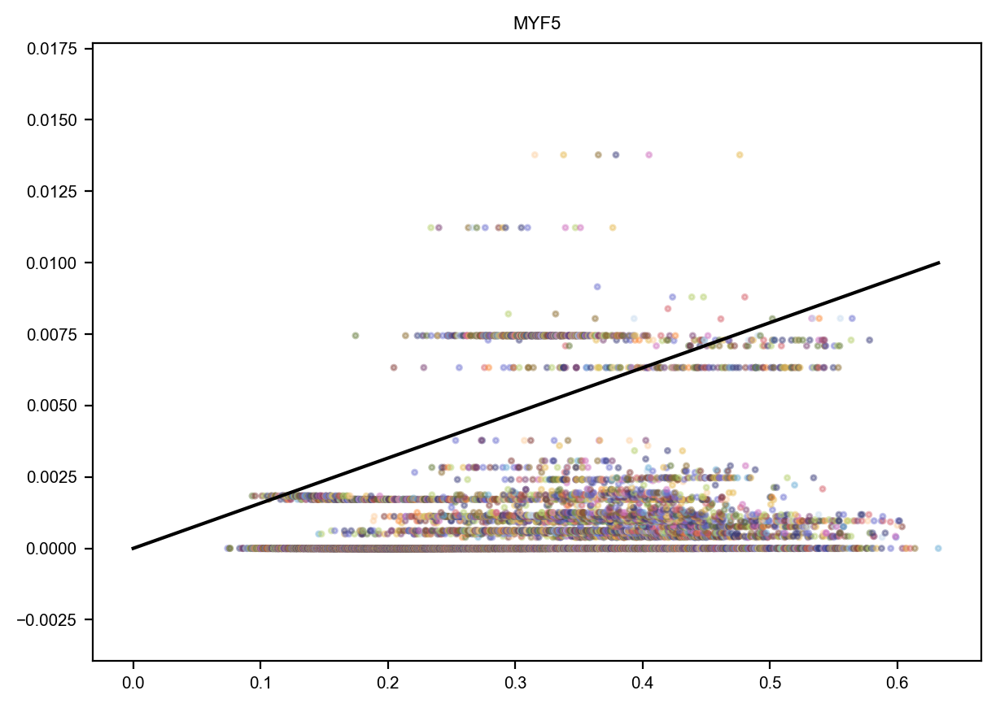

In [81]:
vlm.plot_phase_portraits(["MYF5"])

In [86]:
import umap

In [87]:
from sklearn.manifold import TSNE
bh_tsne = TSNE()
# vlm.ts = bh_tsne.fit_transform(vlm.pcs[:, :25])
vlm.ts = umap.UMAP().fit_transform(vlm.pcs[:, :15])
vlm.estimate_transition_prob(hidim="Sx_sz", embed="ts", transform="sqrt", psc=1,
                             n_neighbors=2000, knn_random=True, sampled_fraction=0.5)
vlm.calculate_embedding_shift(sigma_corr = 0.05, expression_scaling=True)
vlm.calculate_grid_arrows(smooth=0.8, steps=(40, 40), n_neighbors=300)

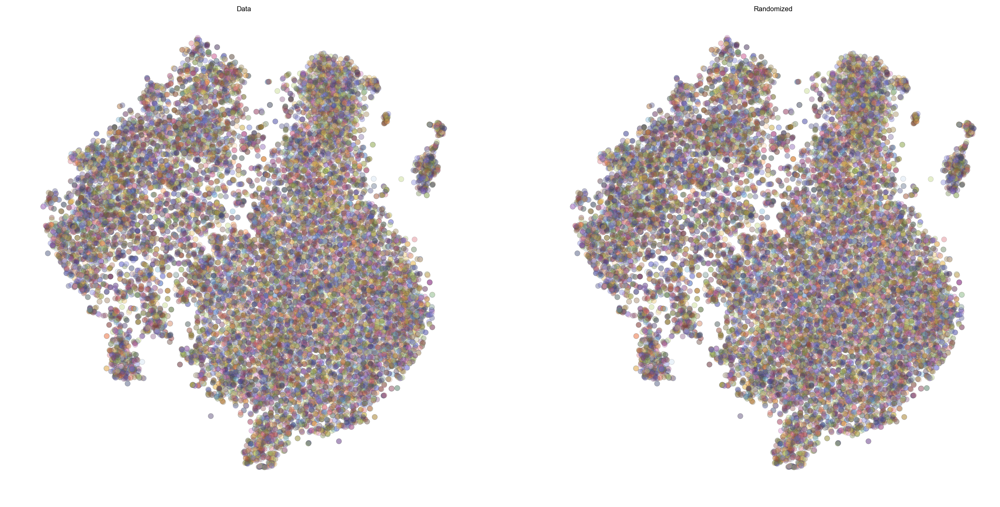

In [85]:
plt.figure(None,(20,10))
vlm.plot_grid_arrows(quiver_scale=0.6,
                    scatter_kwargs_dict={"alpha":0.35, "lw":0.35, "edgecolor":"0.4", "s":38, "rasterized":True}, 
                    min_mass=24, angles='xy', scale_units='xy',
                    headaxislength=2.75, headlength=5, headwidth=4.8, minlength=1.5,
                    plot_random=True, scale_type="absolute")